In [22]:
# geopython env + mxnet1.6.0 env
import numpy as np
import pandas as pd
import imageio
import os
from sklearn.metrics import accuracy_score, matthews_corrcoef, confusion_matrix, r2_score
import higra as hg
import scipy.ndimage as si
from skimage import measure
import pickle
from copy import deepcopy

import matplotlib.pyplot as plt
from matplotlib import colors
import seaborn as sns
%matplotlib inline

# Watershed segmentation on large 4096px images

In [2]:
def InstSegm(extent, boundary, t_ext=0.4, t_bound=0.2):
    """
    INPUTS:
    extent : extent prediction
    boundary : boundary prediction
    t_ext : threshold for extent
    t_bound : threshold for boundary
    OUTPUT:
    instances
    """

    # Threshold extent mask
    ext_binary = np.uint8(extent >= t_ext)

    # Artificially create strong boundaries for
    # pixels with non-field labels
    input_hws = np.copy(boundary)
    input_hws[ext_binary == 0] = 1

    # Create the directed graph
    size = input_hws.shape[:2]
    graph = hg.get_8_adjacency_graph(size)
    edge_weights = hg.weight_graph(
        graph,
        input_hws,
        hg.WeightFunction.mean
    )

    tree, altitudes = hg.watershed_hierarchy_by_dynamics(
        graph,
        edge_weights
    )
    
    # Get individual fields
    # by cutting the graph using altitude
    instances = hg.labelisation_horizontal_cut_from_threshold(
        tree,
        altitudes,
        threshold=t_bound)
    
    instances[ext_binary == 0] = -1

    return instances

In [23]:
def plot_examples(colormaps):
    """
    Helper function to plot data with associated colormap.
    """
    np.random.seed(19680801)
    data = np.random.randn(30, 30)
    n = len(colormaps)
    fig, axs = plt.subplots(1, n, figsize=(n * 2 + 2, 3),
                            constrained_layout=True, squeeze=False)
    for [ax, cmap] in zip(axs.flat, colormaps):
        psm = ax.pcolormesh(data, cmap=cmap, rasterized=True, vmin=-4, vmax=4)
        fig.colorbar(psm, ax=ax)
    plt.show()

In [153]:
i = np.random.choice(np.arange(1000))
image_id = 'maharashtra_{}'.format(str(i).zfill(4))
print(image_id)

img_dir = '../data/maharashtra/airbus_false_color_4096px/'
results_dir = '../data/maharashtra/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/'
example_img = imageio.imread(os.path.join(img_dir, '{}.png'.format(image_id)))
example_extent = imageio.imread(os.path.join(results_dir, 'extent_4096px/{}.png'.format(image_id)))
example_extent = np.array(example_extent, dtype=np.float32) / 255.
example_boundary = imageio.imread(os.path.join(results_dir, 'boundary_4096px/{}.png'.format(image_id)))
example_boundary = np.array(example_boundary, dtype=np.float32) / 255.

instances = InstSegm(example_extent, example_boundary, t_ext=0.15, t_bound=0.2)

maharashtra_0415


## Visualize instances

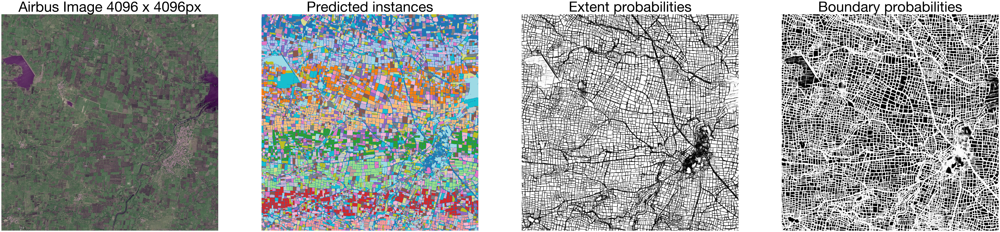

In [21]:
# map instances to better range for plotting
unique_instances = sorted(np.unique(instances))
min_instance = unique_instances[1]
max_instance = unique_instances[-1]
n_instances = len(unique_instances)
instance_map = {x: i for i, x in enumerate(unique_instances)}
def map_values(x):
    return instance_map[x]
instances_mapped = np.array(list(map(map_values, instances.flatten()))).reshape( 
    instances.shape[0], instances.shape[1])

fig, ax = plt.subplots(1, 4, figsize=(90,24))
fs = 72
ax[0].imshow(example_img)
ax[0].set_title('Airbus Image 4096 x 4096px', fontsize=fs)
ax[1].imshow(instances_mapped, vmin=0, vmax=n_instances+1, cmap='tab20')
ax[1].set_title('Predicted instances', fontsize=fs)
ax[2].imshow(example_extent, cmap='Greys_r', vmin=0, vmax=1)
ax[2].set_title('Extent probabilities', fontsize=fs)
ax[3].imshow(example_boundary, cmap='Greys_r', vmin=0, vmax=1)
ax[3].set_title('Boundary probabilities', fontsize=fs)
for i in range(4):
    ax[i].axis('off')

plt.show()

## Different way of visualizing field instances

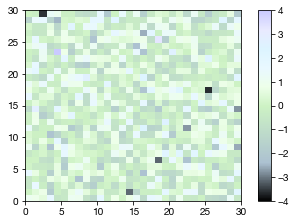

In [24]:
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
nodes = [0.0, 0.2, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
colors = ['#000000', '#ACC1D1', '#CDF2C4', '#EDFFE9', '#E9F8FF', '#DCF4FF', '#E9EAFF', '#CACAFF']
cmap2 = LinearSegmentedColormap.from_list("mycmap", list(zip(nodes, colors)))
plot_examples([cmap2])

In [154]:
instances_pred = measure.label(instances, background=-1)
instances_str = instances_pred.astype(str)
hashall = np.vectorize(hash)
hashed = hashall(instances_str)
instances_hashed = hashed % 1000

In [155]:
new_instances = 0.2 * (deepcopy(instances_pred) > 0)
new_instances = (instances_hashed.astype(float) + 600) / 1600. 
mask = instances_pred > 0

In [156]:
len(np.unique(instances_pred))

6627

In [157]:
np.save('../data/maharashtra/fractal-resunet_Airbus_nfilter-32_depth-6_bs-5_lr-0.001_3x-downsampled-erosion2px_finetuned/instances_4096px/{}.npy'.format(image_id),
        instances_pred)

In [158]:
boundary_mask = np.ones((img_size, img_size), dtype=bool)
boundary_mask[:img_size-2,:img_size-2] = ((instances_pred[2:,:] == instances_pred[:-2,:])[:,:img_size-2] 
                                          & (instances_pred[:,2:] == instances_pred[:,:-2])[:img_size-2,:] 
                                          & (instances_pred[2:,2:] == instances_pred[:-2,:-2]) 
                                          & (instances_pred[:-2,2:] == instances_pred[2:,:-2]))

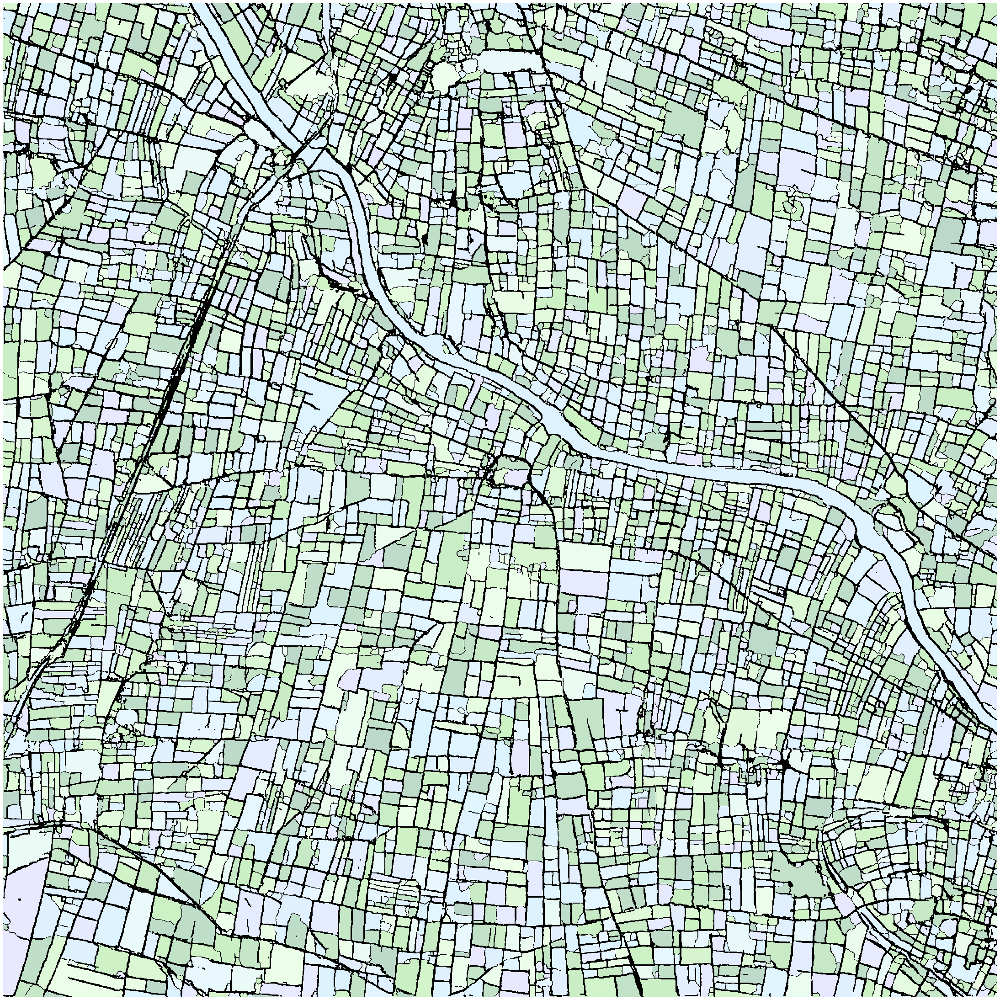

In [159]:
fig, ax = plt.subplots(1, figsize=(40,40))
plt.imshow(new_instances * mask * boundary_mask, cmap=cmap2, vmin=0, vmax=1.1)
ax.axis('off')
plt.show()

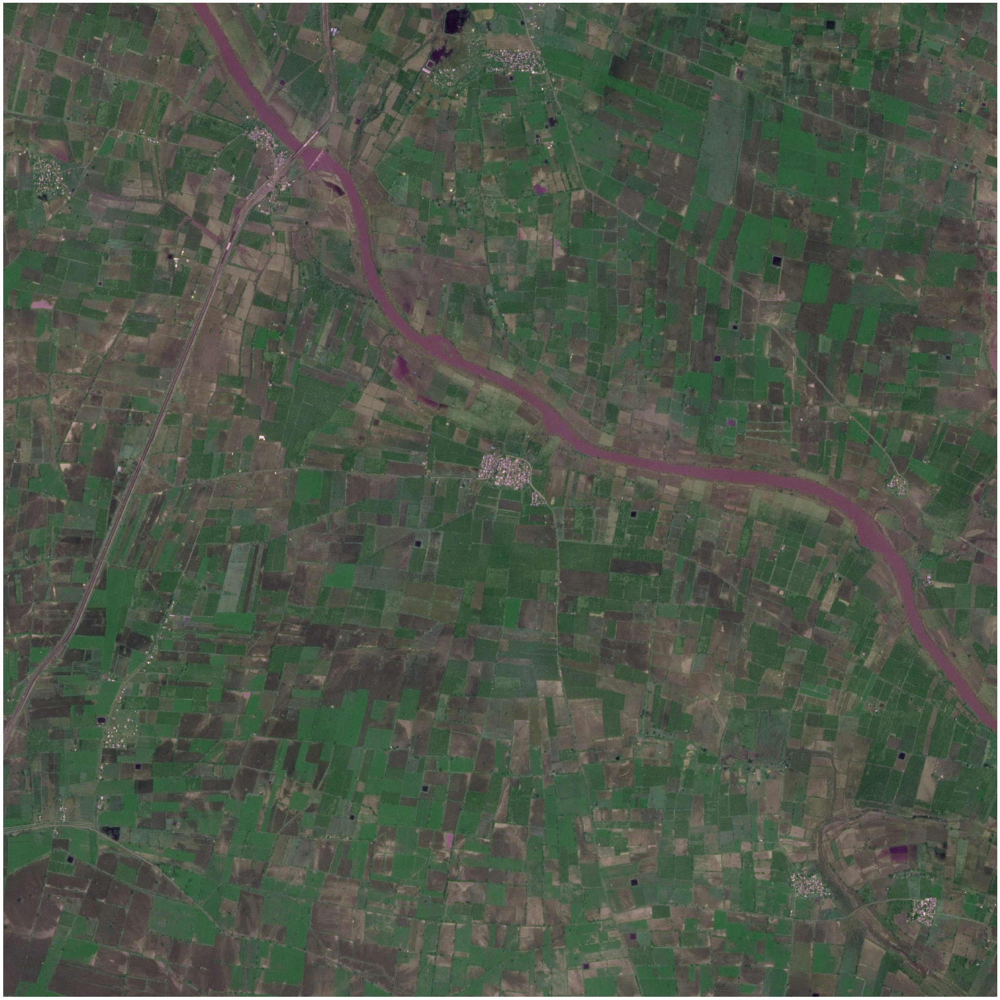

In [160]:
fig, ax = plt.subplots(1, figsize=(40,40))
plt.imshow(example_img)
ax.axis('off')
plt.show()

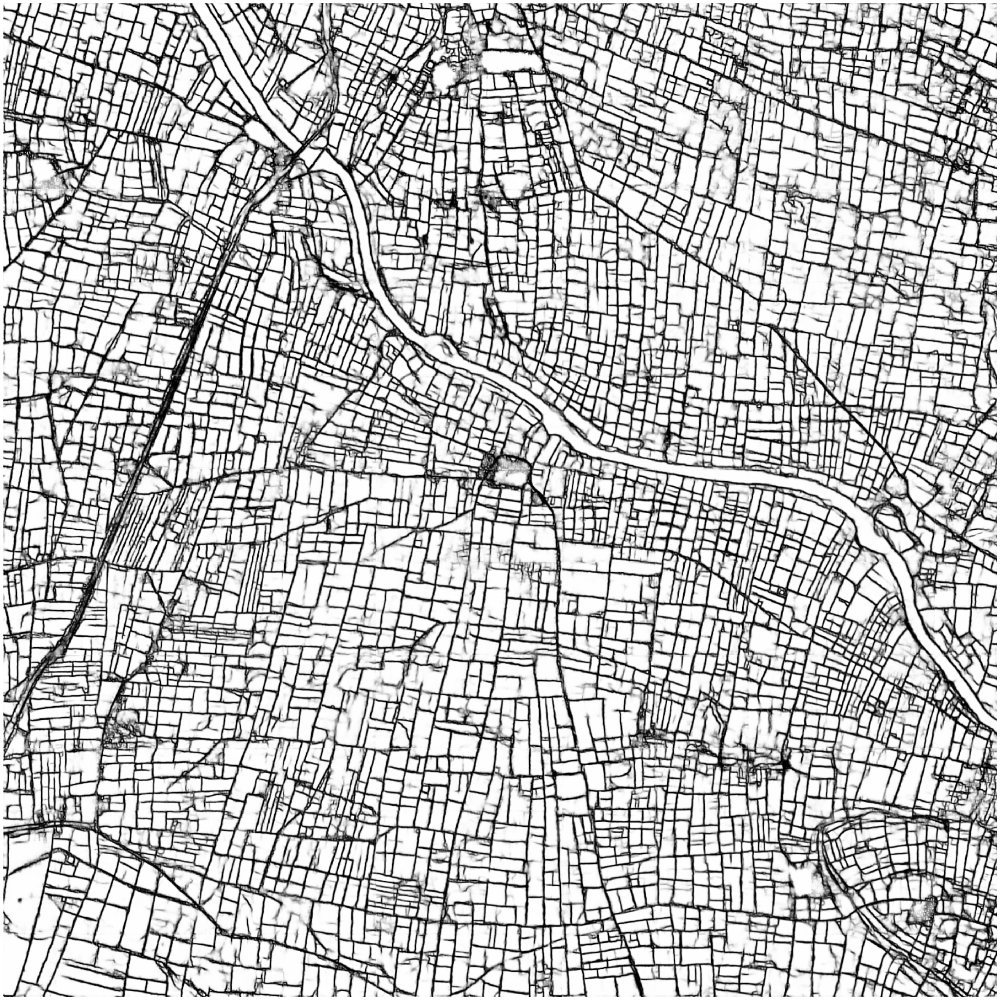

In [161]:
fig, ax = plt.subplots(1, figsize=(40,40))
plt.imshow(example_extent, cmap='Greys_r')
ax.axis('off')
plt.show()

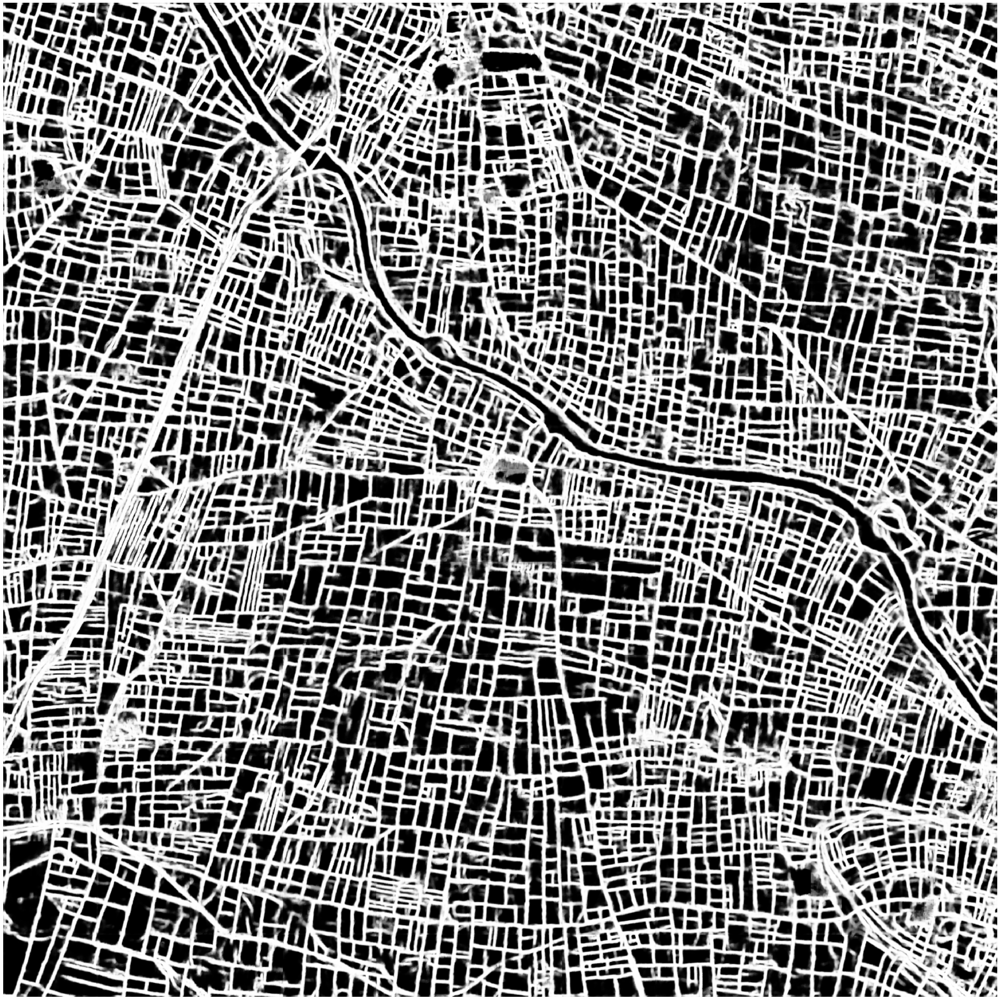

In [162]:
fig, ax = plt.subplots(1, figsize=(40,40))
plt.imshow(example_boundary, cmap='Greys_r')
ax.axis('off')
plt.show()

## Dev - trying to figure out instance uncertainty

In [108]:
# t_ext = 0.15

# # Threshold extent mask
# ext_binary = np.uint8(example_extent >= t_ext)

# # Artificially create strong boundaries for
# # pixels with non-field labels
# input_hws = np.copy(example_boundary)
# input_hws[ext_binary == 0] = 1

# # Create the directed graph
# size = input_hws.shape[:2]
# graph = hg.get_8_adjacency_graph(size)
# edge_weights = hg.weight_graph(
#     graph,
#     input_hws,
#     hg.WeightFunction.mean
# )

# tree, altitudes = hg.watershed_hierarchy_by_dynamics(
#     graph,
#     edge_weights
# )

In [116]:
edge_weights.shape

(67084290,)